In [8]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2
import os
from os.path import dirname, abspath
import tensorflow as tf
import glob
import sys
import datetime
import random
import numpy as np
import cv2

# matplotlib.use('QT5Agg')
from cucu_config import cucumberConfig, InferenceConfig
from cucu_config import cucuConfForTrainingSession as config
from cucu_config import globalObjectCategories
from project_assets.cucu_classes import genDataset, CucuLogger, project_paths,HybridDataset, realDataset
from project_assets.cucu_utils import get_ax

from PIL import Image
import json
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log
from shutil import copyfile, copytree
from keras.callbacks import EarlyStopping,LearningRateScheduler
import math
import pprint

from cucu_train import initiateAllPathsForCurrentSession
#handle paths,new folders and logger
# cucuPaths = initiateAllPathsForCurrentSession("/home/simon/Mask_RCNN","/home/simon/Mask_RCNN/cucu_train/trainResultContainers/trainResults_4-9-23")



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
model_basedir = "/home/simon/Mask_RCNN/cucu_train/trainResultContainers/tagged"
val_dataset_basedir = "/home/simon/Documents/cucu_dataset/real"

model_dirs = os.listdir(model_basedir)
models = {}
datasets = {}

models["cucumber"] = [d for d in model_dirs if "cucumber_only" in d]
models["leaf"] = [d for d in model_dirs if "leaf_only" in d]
models["flower"] = [d for d in model_dirs if "flower_only" in d]
models["stem"] = [d for d in model_dirs if "stem_only" in d]
# models["mixed"] = [d for d in model_dirs if "cucumber_leaf_flower"]

for category in models:
    resolutions = ["512", "1024"]
#     dataset_dirs = [os.path.join(val_dataset_basedir, resolution, category, "valid") for resolution in resolutions]
    datasets[category] = {}
    for resolution in resolutions:
        datasets[category][resolution] = {}
        datasets[category][resolution]["dataset"] = os.path.join(val_dataset_basedir, resolution, category, "valid")
        datasets[category][resolution]["models"] = [model for model in models[category] if resolution in model]
        

# datasets["cucumber"] = os.path.join(model_basedir, "")
pprint.pprint(datasets)

{'cucumber': {'1024': {'dataset': '/home/simon/Documents/cucu_dataset/real/1024/cucumber/valid',
                       'models': ['cucumber_only_generated(2000)_1024_blur3_erode5_IoU_50',
                                  'mixed_2_epochs_cucumber_only_generated(10000)_1024_IoU_50',
                                  'cucumber_only_generated(2000)_1024_noblur_noerode_IoU_50',
                                  'cucumber_only_real_augmented(2000)_1024_IoU_50',
                                  '0cucumber_only_real_augmented(10000)_1024_IoU_50']},
              '512': {'dataset': '/home/simon/Documents/cucu_dataset/real/512/cucumber/valid',
                      'models': ['cucumber_only_real_augmented(2000)_512_IoU_50',
                                 'cucumber_only_generated(2000)_512_blur3_erode_5_IoU_50']}},
 'flower': {'1024': {'dataset': '/home/simon/Documents/cucu_dataset/real/1024/flower/valid',
                     'models': ['flower_only_generated(2000)_1024_blur3_erode5_IoU_50'

Loading weights from  /home/simon/Mask_RCNN/cucu_train/trainResultContainers/tagged/cucumber_only_real_augmented(2000)_512_IoU_50
/home/simon/Mask_RCNN/cucu_train/trainResultContainers/tagged/cucumber_only_real_augmented(2000)_512_IoU_50/trained_models/cucuWheights_2019-04-14 15:43:37.003370.h5
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
image ID: coco.13 (13) 
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.08847  max:    1.02591  float32
image ID: coco.2 (2) 
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -1

FileNotFoundError: [Errno 2] No such file or directory: '/home/simon/Documents/cucu_dataset/real/1024/leaf/valid/annotations.json'

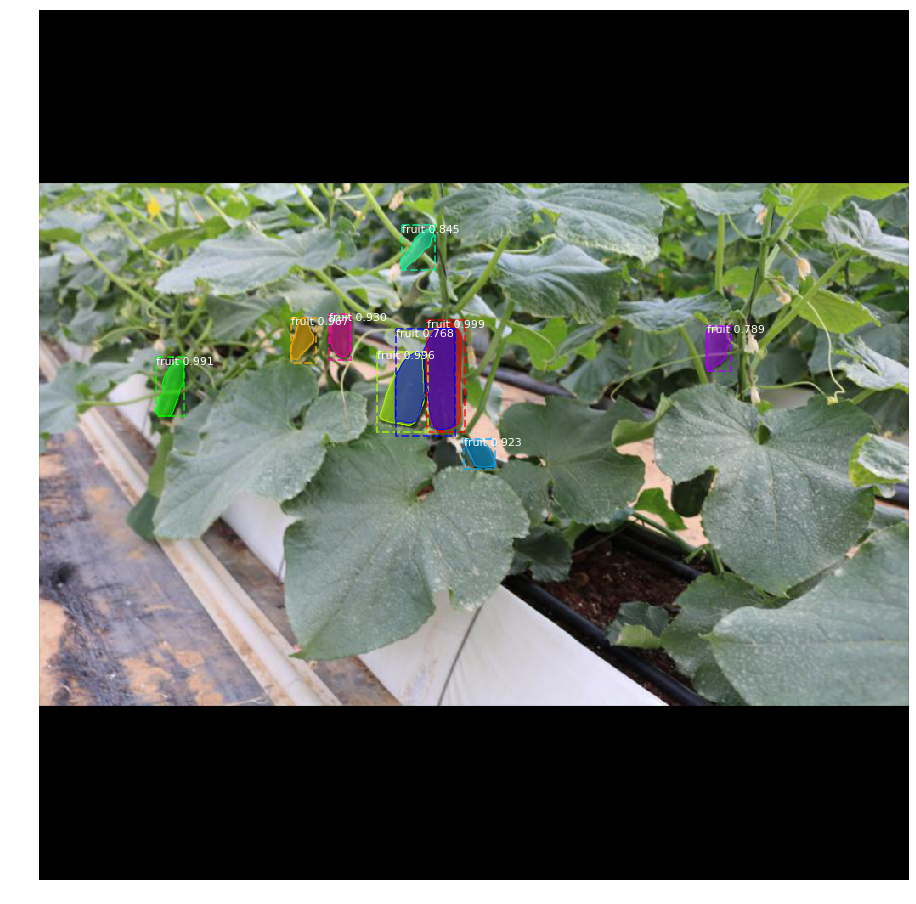

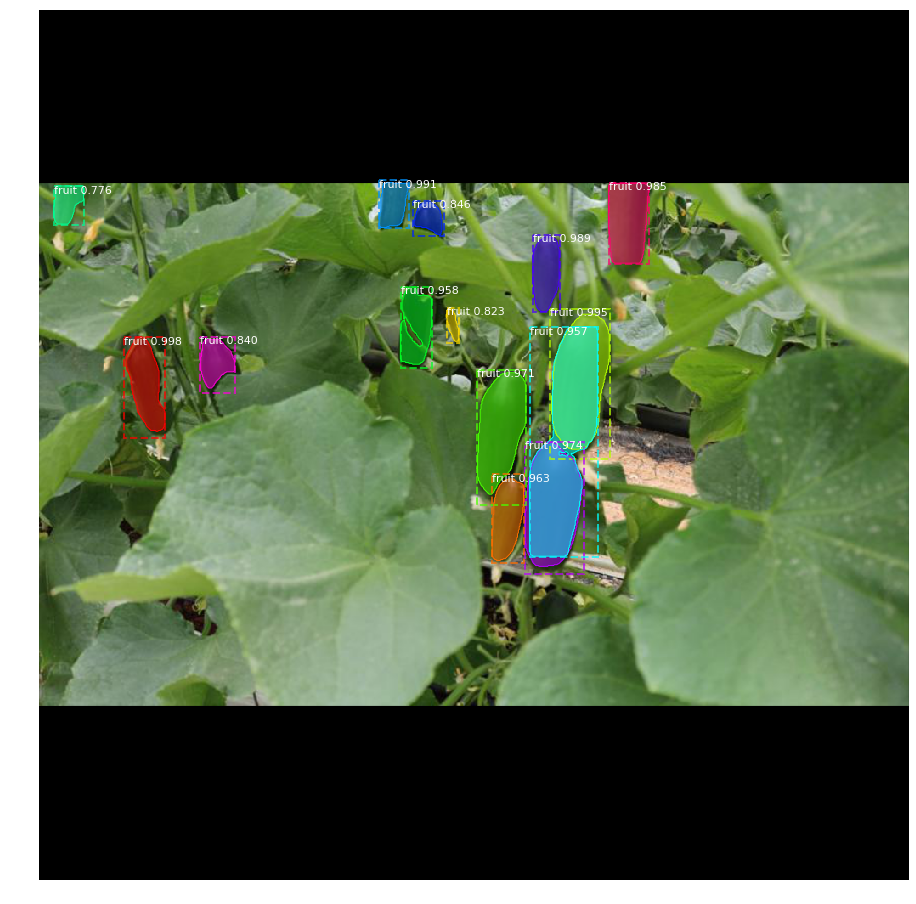

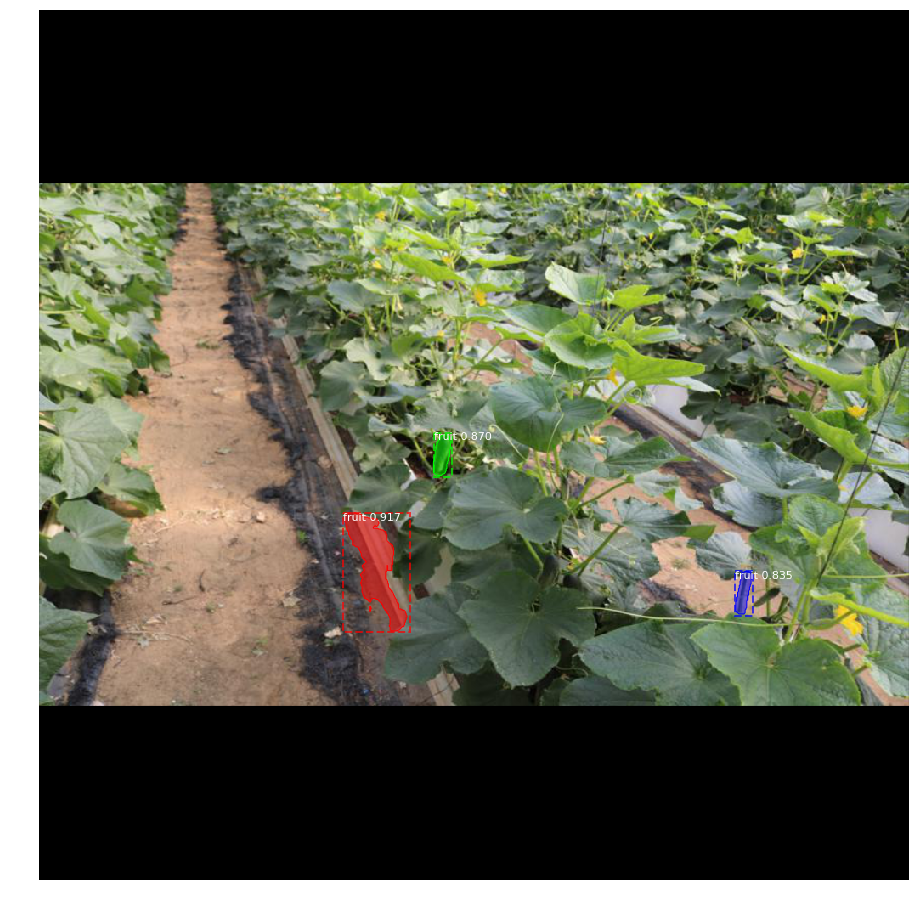

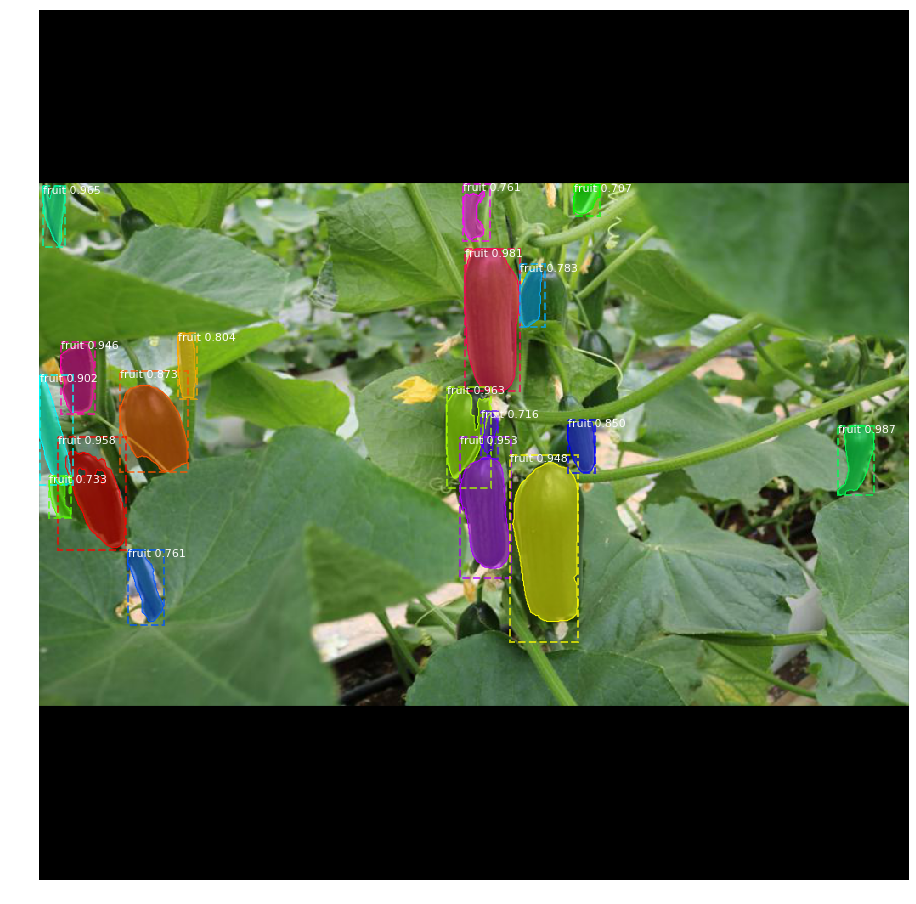

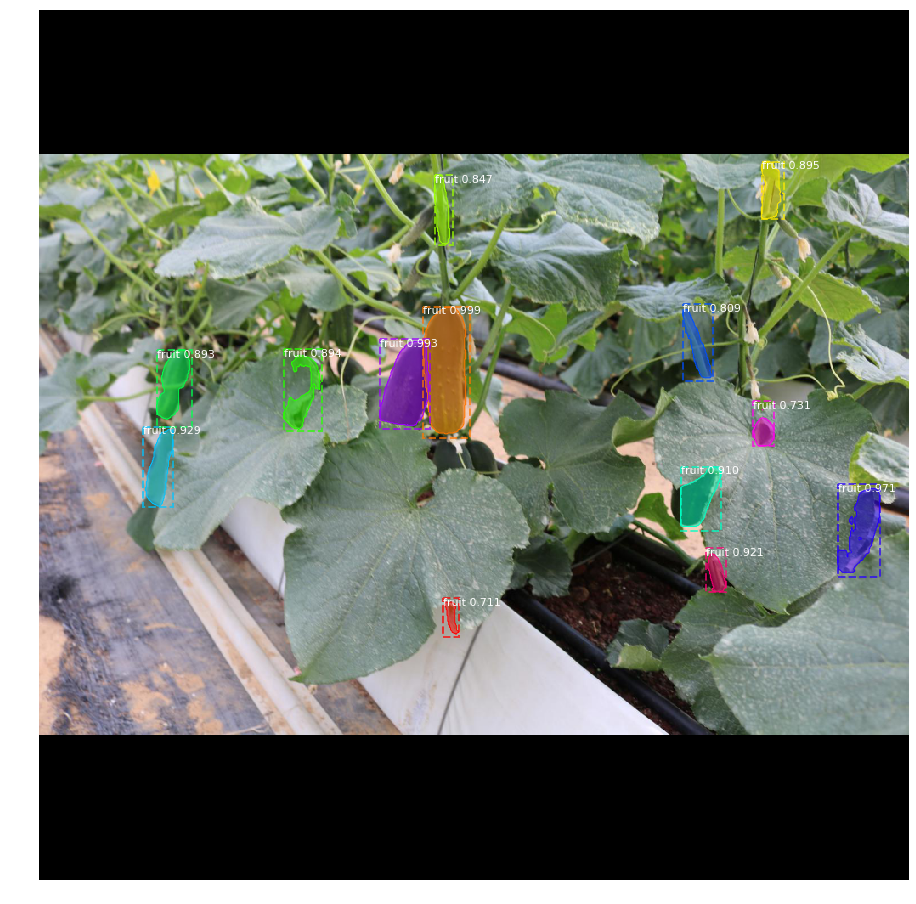

...

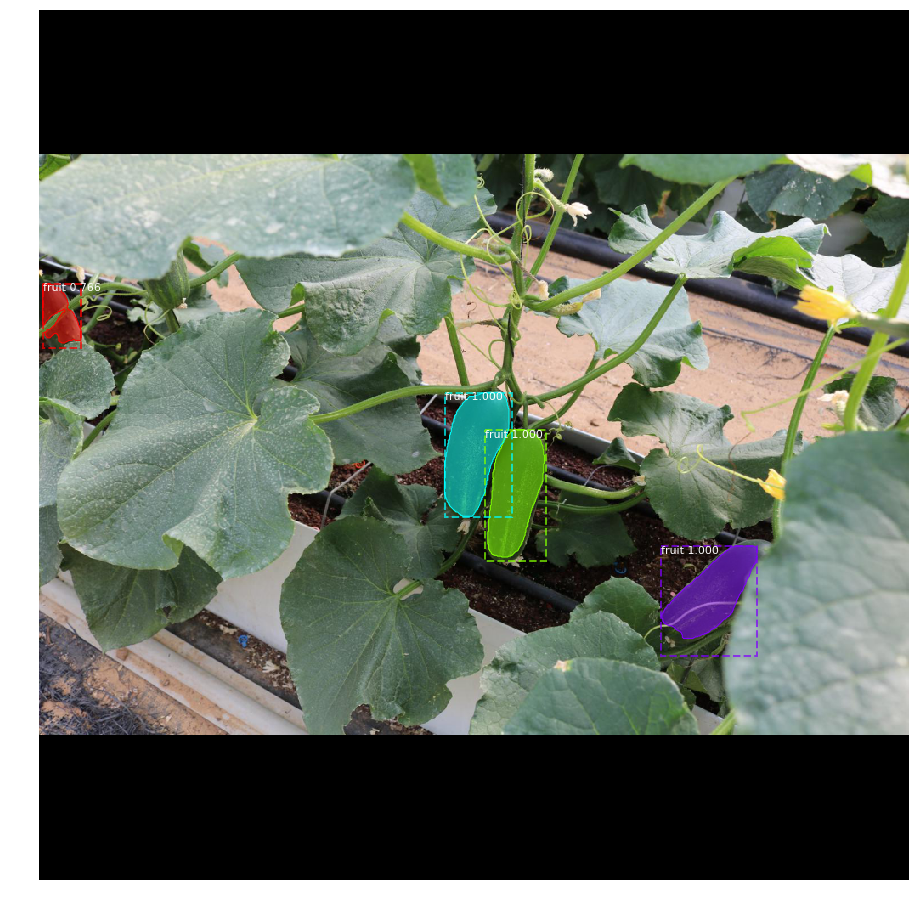

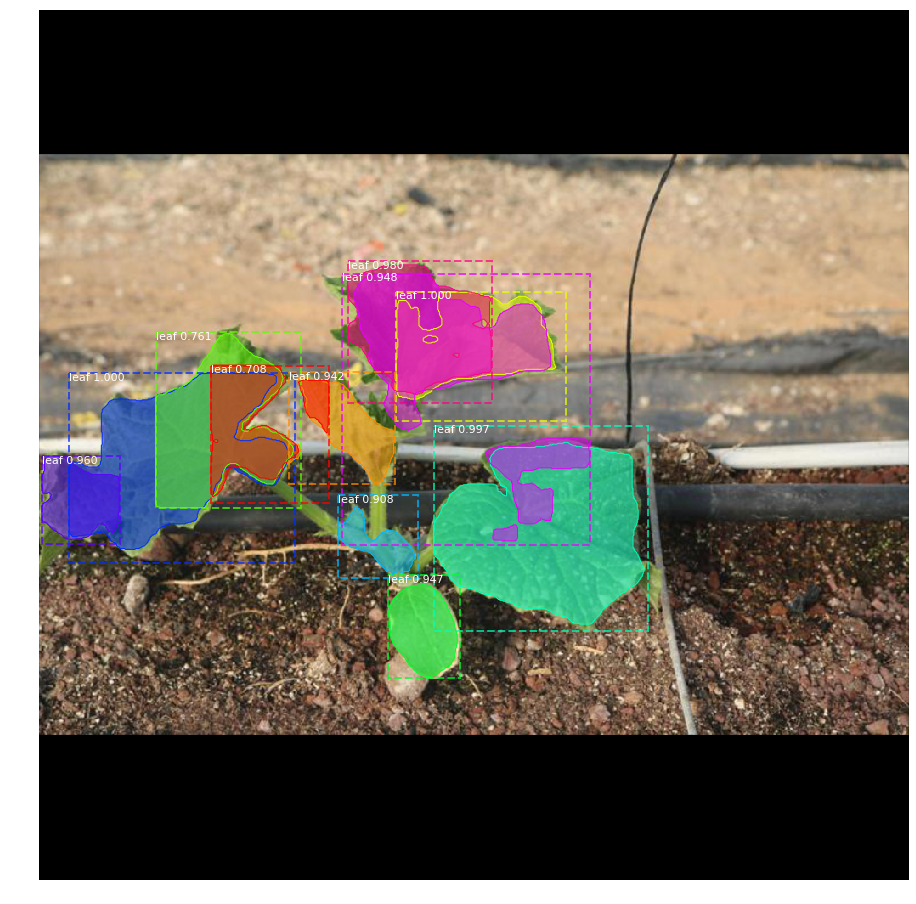

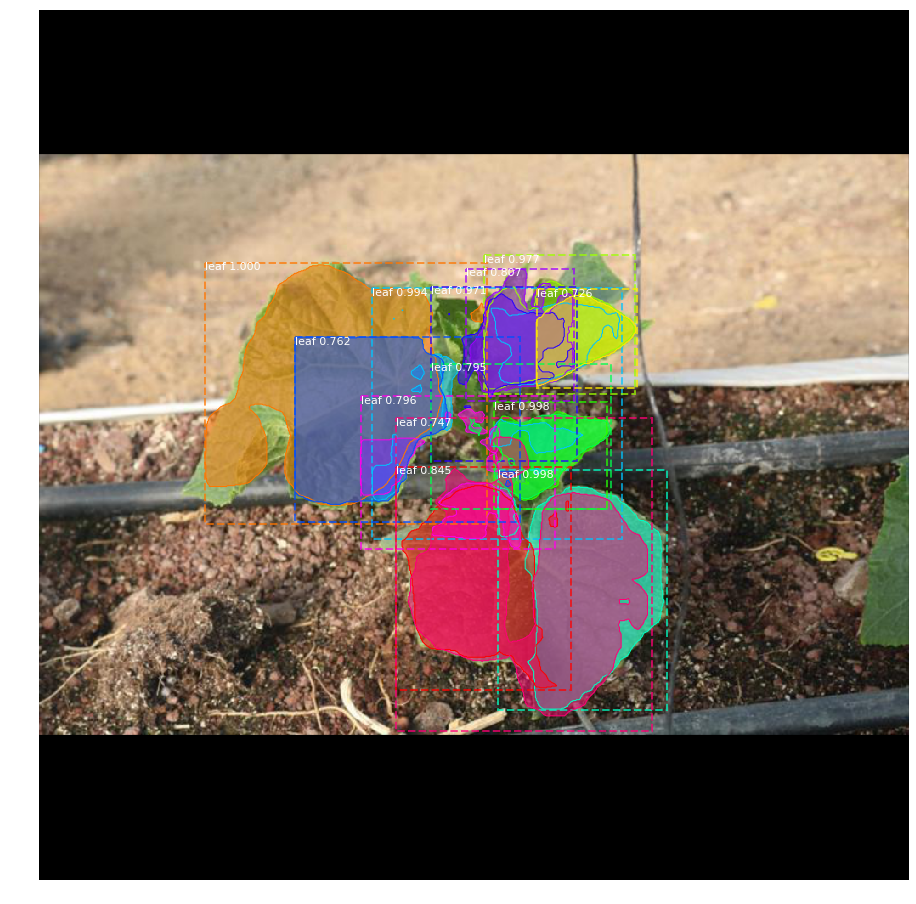

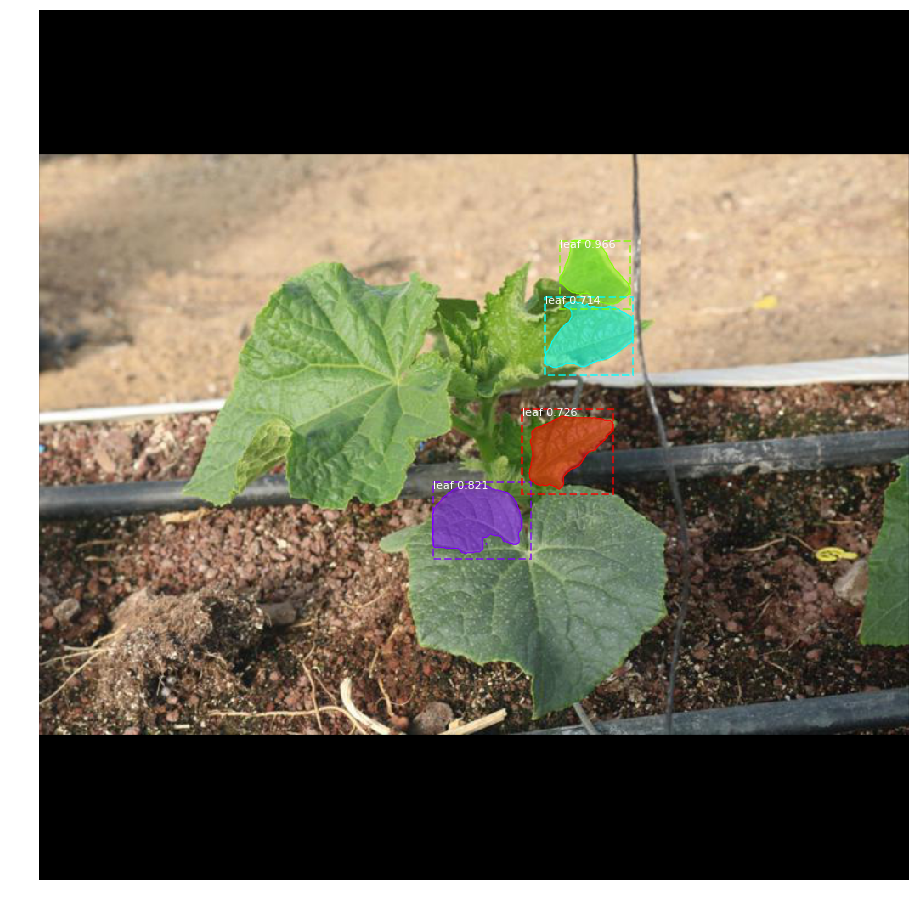

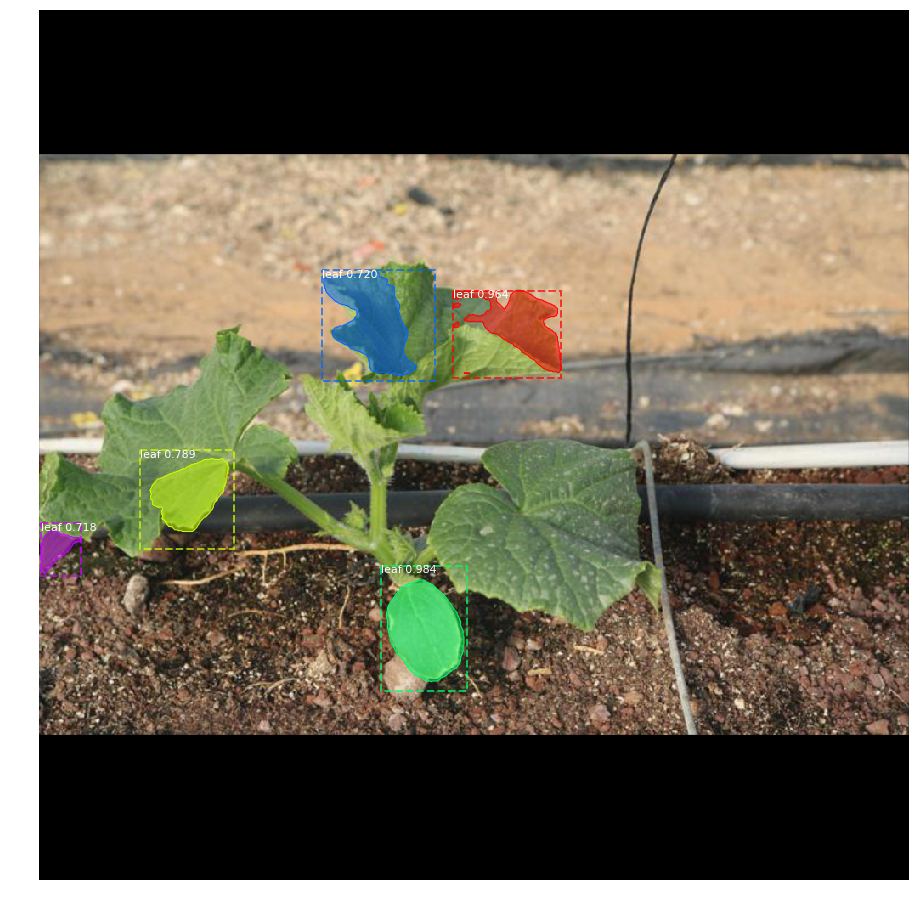

In [10]:
inference_config = InferenceConfig()

# Validation dataset
for category in datasets:
    for resolution in datasets[category]:
        for model_dir in datasets[category][resolution]["models"]:
            # Recreate the model in inference mode
            model_dir = os.path.join(model_basedir, model_dir)
            model = modellib.MaskRCNN(mode="inference", config=inference_config, model_dir=os.path.join(model_dir, "TensorBoardGraphs"))

            # Load trained weights
            print("Loading weights from ", model_dir)
            model_weights = os.path.join(model_dir,"trained_models", os.listdir(os.path.join(model_dir, "trained_models"))[0])
            print(model_weights)
            model.load_weights(model_weights, by_name=True)
            
            
            # Load valid dataset
            dataset_val = realDataset()
            dataset_val.load_dataset(os.path.join(datasets[category][resolution]["dataset"],"annotations.json"), datasets[category][resolution]["dataset"])
            dataset_val.prepare()
            
            dataset = dataset_val
            n = 2
            image_ids = np.random.choice(dataset.image_ids, n)
            for image_id in image_ids:
                image, image_meta, gt_class_id, gt_bbox, gt_mask =\
                    modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
                info = dataset.image_info[image_id]
                print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                                    dataset.image_reference(image_id)))
                # Run object detection
                results = model.detect([image], verbose=1)

                # Display results
            #     ax = get_ax(1)
                r = results[0]
            #     visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], dataset.class_names, r['scores'], title="Predictions", savePath=None)
                visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], dataset.class_names, r['scores'], savePath=None)
                plt.show()


(1024, 1536, 3)
figure size: 14


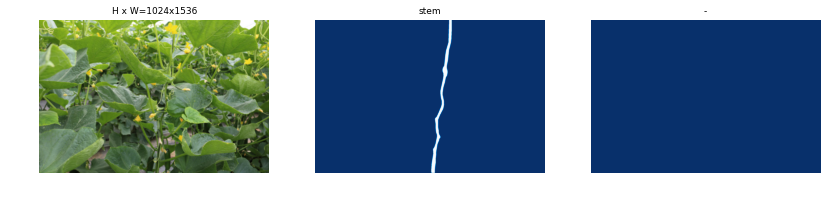

(1024, 1536, 3)
figure size: 14


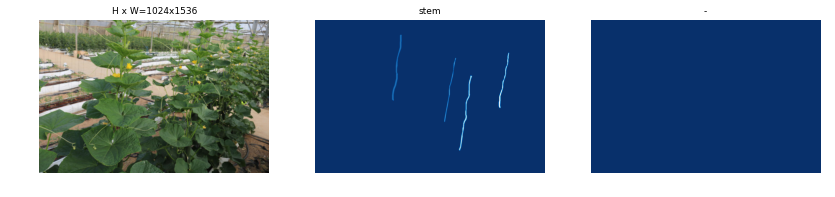

(1024, 1536, 3)
figure size: 14


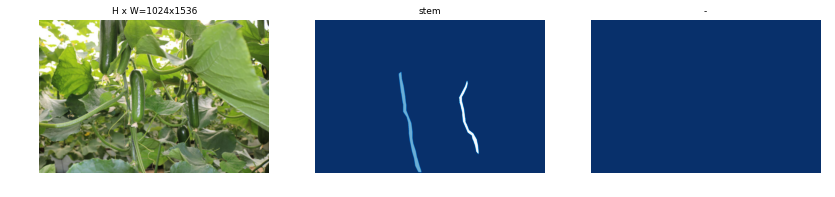

(1024, 1536, 3)
figure size: 14


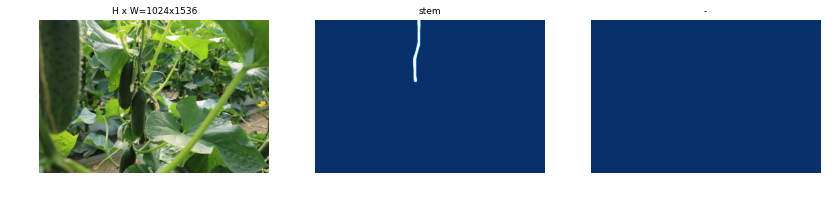

(1024, 1536, 3)
figure size: 14


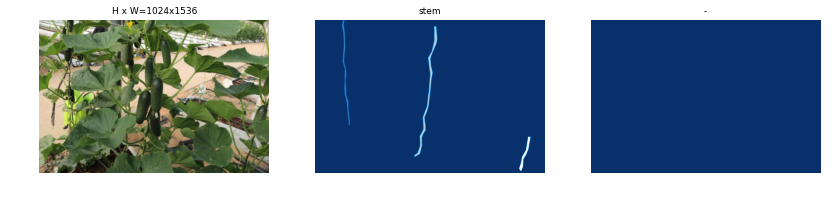

In [13]:
#show n random image&mask train examples
n = 5
image_ids = np.random.choice(dataset_val.image_ids, n)
for image_id in image_ids:
    image = dataset_val.load_image(image_id)
    mask, class_ids = dataset_val.load_mask(image_id)
    print(image.shape)
    visualize.display_top_masks(image, mask, class_ids, dataset_val.class_names, None, 2)

In [ ]:
# class InferenceConfig(cucumberConfig):
#     GPU_COUNT = 1
#     IMAGES_PER_GPU = 1

# inference_config = InferenceConfig()

# # Recreate the model in inference mode
# model = modellib.MaskRCNN(mode="inference", config=inference_config, model_dir=cucuPaths.TensorboardDir)

# # Load trained weights
# list_of_trained_models = glob.glob(cucuPaths.trainedModelsDir +'/*')
# latest_trained_model = max(list_of_trained_models, key=os.path.getctime)

# print("Loading weights from ", latest_trained_model)
# model.load_weights(latest_trained_model, by_name=True)

In [7]:
# DISPLAY_TOP_MASKS
#create container directories per function calls from Visualize module
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/display_top_masks")
tests_location = cucuPaths.testDatasetDir

# n = 5
# for filename in sorted(os.listdir(tests_location))[:n]: 
#     testImage = os.path.join(tests_location,filename)
#     try:
#         t = cv2.cvtColor(cv2.imread(testImage), cv2.COLOR_BGR2RGB)
#     except Exception as e:
#         print("error: {}, \n probably a non image file is in the directory".format(e))
#         continue
#     results = model.detect([t], verbose=1)
#     r = results[0]
#     # visualize.display_instances(t, r['rois'], r['masks'], r['class_ids'] ,dataset_train.class_names, r['scores'], ax=get_ax())
#     visualize.display_top_masks(t, r['masks'], r['class_ids'] ,dataset_val.class_names, savePath=None )

#     t= dataset_val.class_names
#     print(t)

AttributeError: 'project_paths' object has no attribute 'testDatasetDir'

image ID: coco.63 (63) 
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.08847  max:    1.02591  float32
gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:  147.00000  max: 1023.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool
image_id  63 
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
mask                     shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool
class_ids                shape: (3,)                  min:    1.00000  max:    1.00000  int32


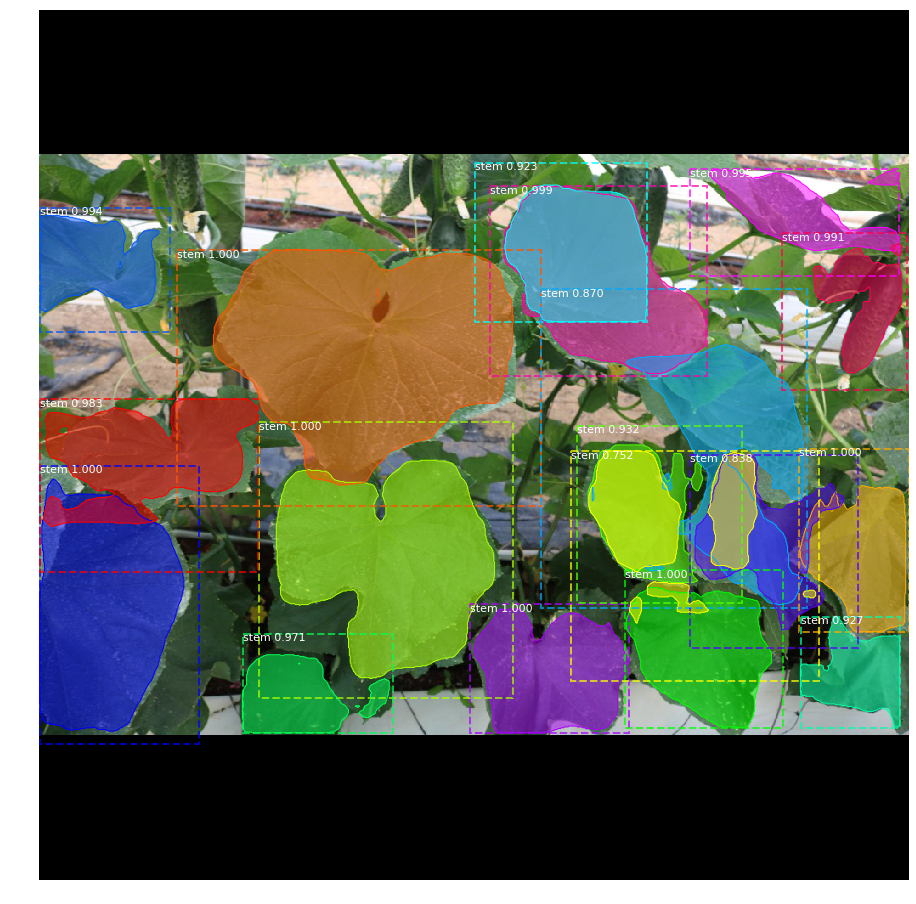

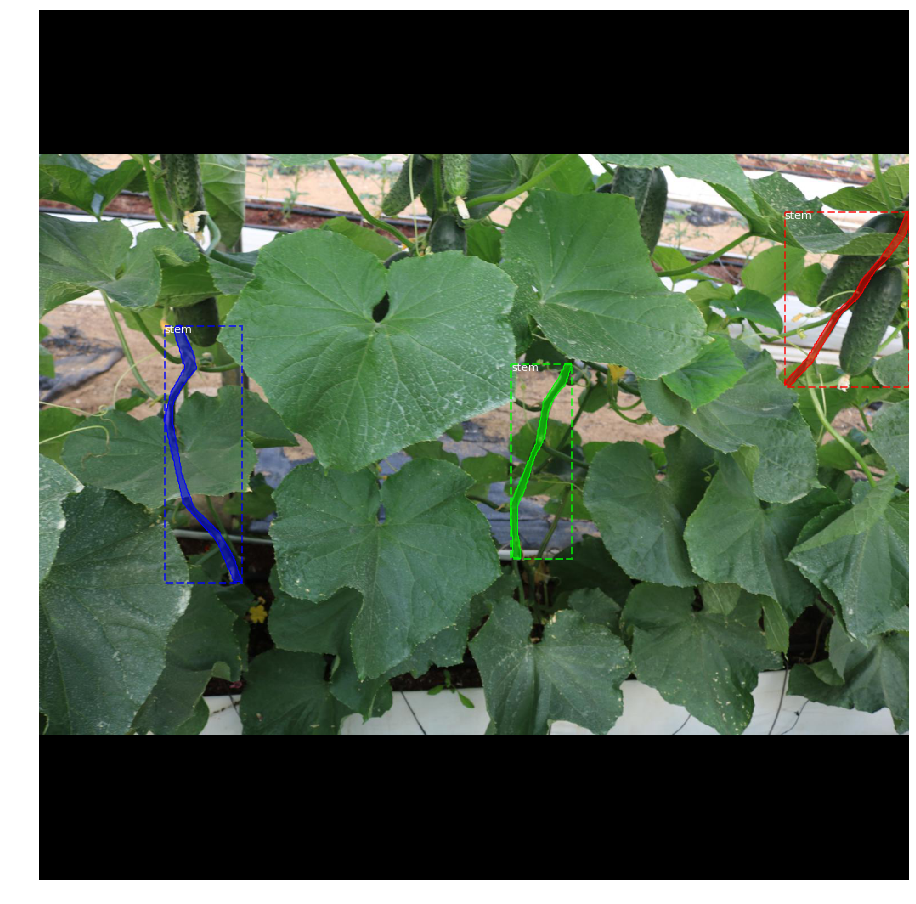

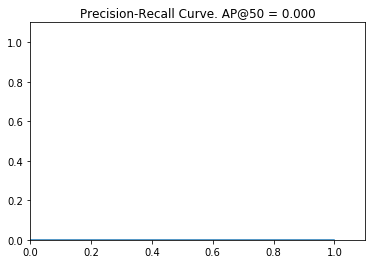

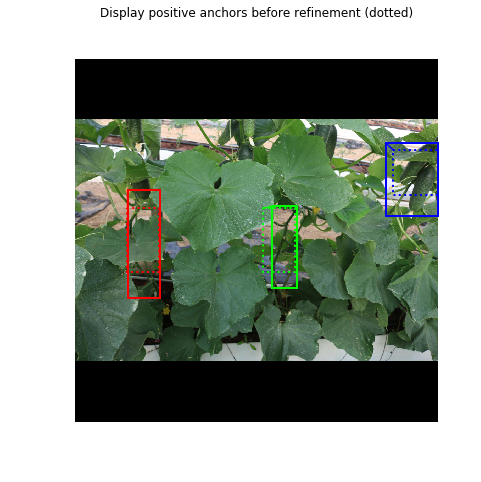

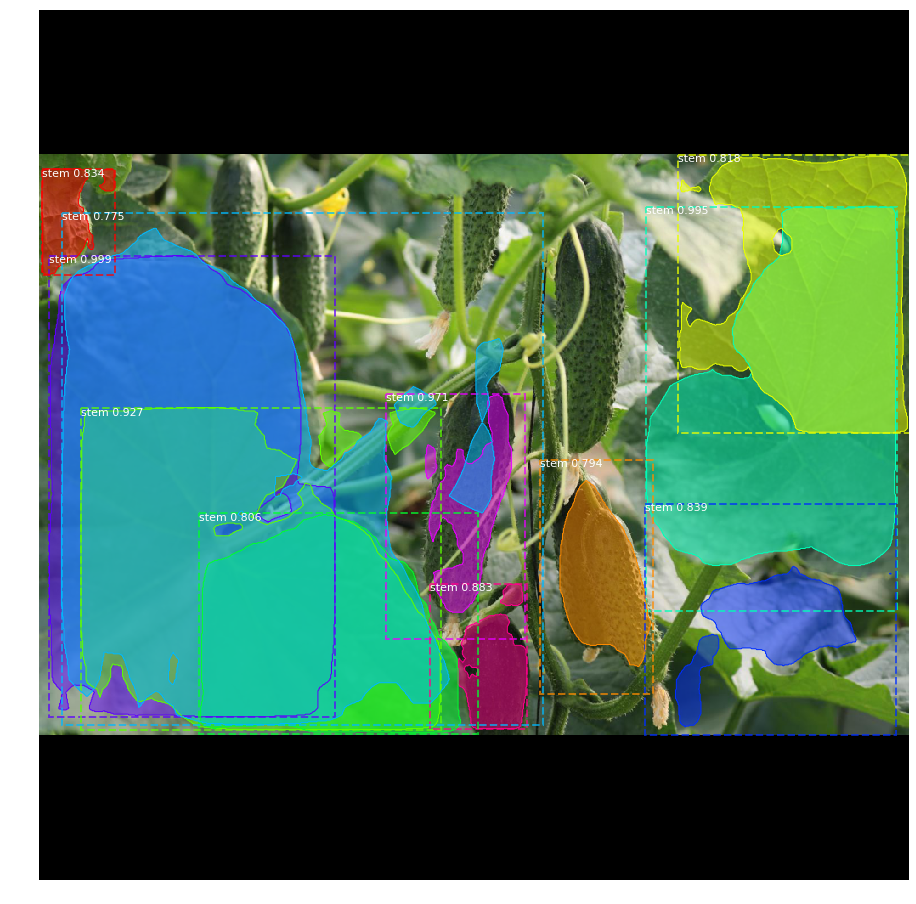

...

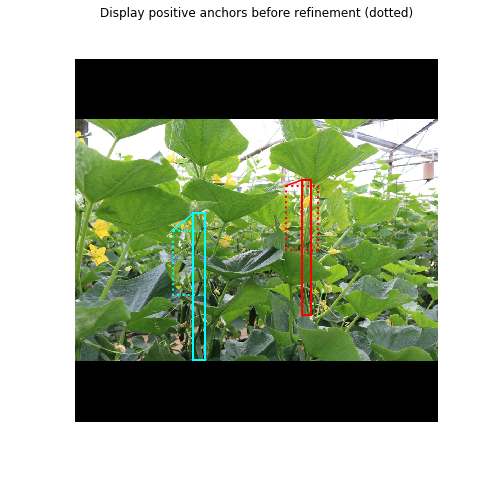

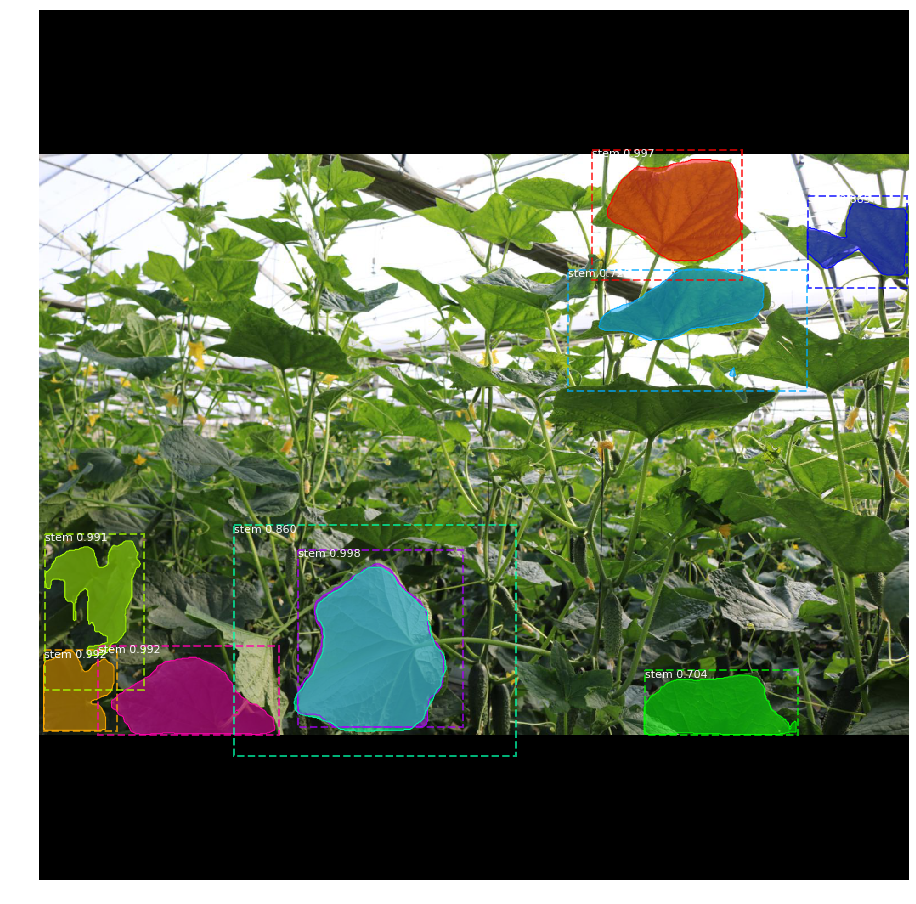

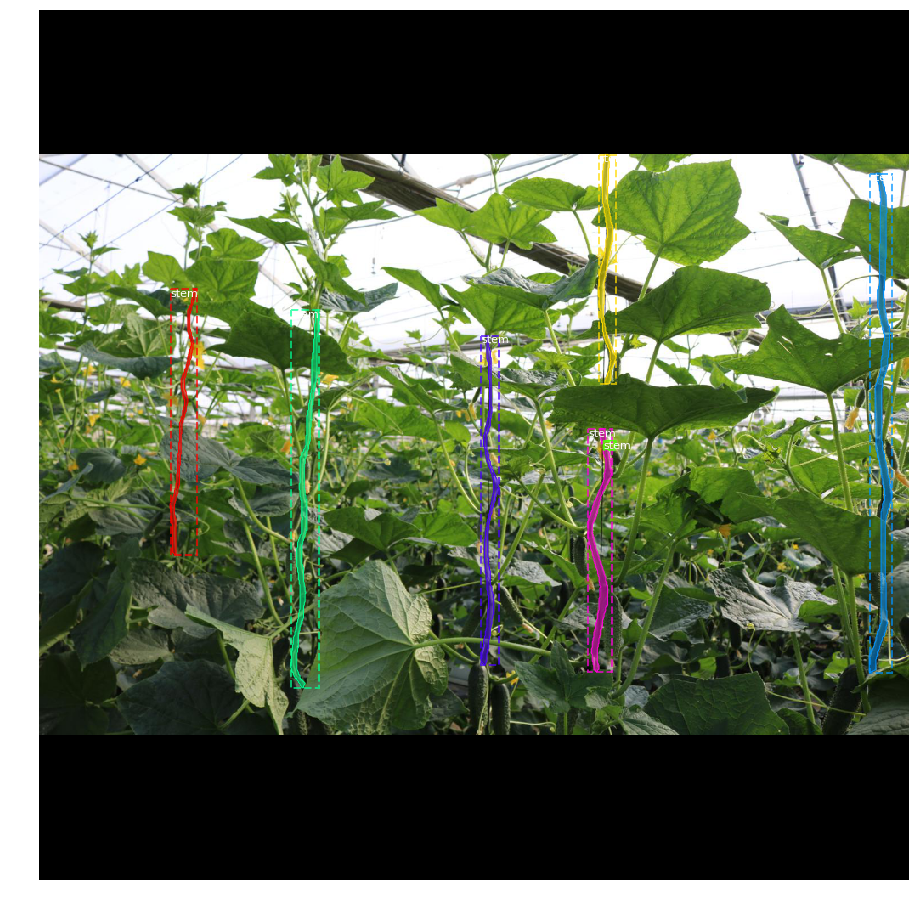

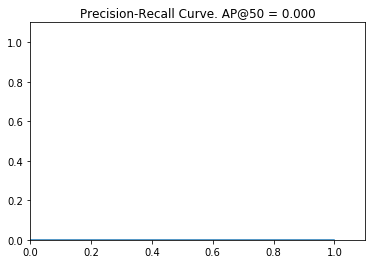

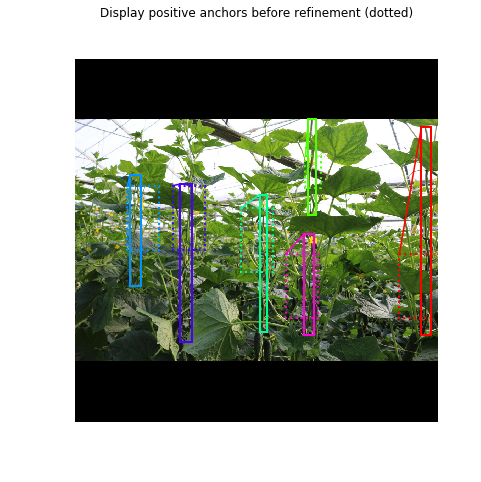

In [14]:
# DISPLAY_INSTANCES
#create container directories per function calls from Visualize module
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/display_instances")
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/plot_precision_recall")
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/plot_overlaps")
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/draw_boxes")
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/masks_detections")
# os.mkdir(cucuPaths.visualizeEvaluationsDir + "/activationsImages")

# in future we want to generate from dataset_test!
dataset = dataset_val

n = 5
image_ids = np.random.choice(dataset.image_ids, n)
for image_id in image_ids:
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
    info = dataset.image_info[image_id]
    print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                        dataset.image_reference(image_id)))
    # Run object detection
    results = model.detect([image], verbose=1)

    # Display results
#     ax = get_ax(1)
    r = results[0]
#     visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], dataset.class_names, r['scores'], title="Predictions", savePath=None)
    visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], dataset.class_names, r['scores'], savePath=None)

    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)

    # Load random image and mask.
#     image = dataset.load_image(image_id)
#     mask, class_ids = dataset.load_mask(image_id)
    mask = gt_mask
    class_ids = gt_class_id
    bbox = gt_bbox
    # Compute Bounding box
#     bbox = utils.extract_bboxes(mask)

    # Display image and additional stats
    print("image_id ", image_id, dataset.image_reference(image_id))
    log("image", image)
    log("mask", mask)
    log("class_ids", class_ids)
    log("bbox", bbox)
    
    # Display image and instances
    visualize.display_instances(image, bbox, mask, class_ids, dataset.class_names, savePath=None)

    # Draw precision-recall curve
    AP, precisions, recalls, overlaps = utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                                            r['rois'], r['class_ids'], r['scores'], r['masks'])
    visualize.plot_precision_recall(AP, precisions, recalls, savePath=None)

    # Grid of ground truth objects and their predictions
#     visualize.plot_overlaps(gt_class_id, r['class_ids'], r['scores'],
#                         overlaps, dataset.class_names, savePath=None)
    
    # Generate RPN trainig targets
    # target_rpn_match is 1 for positive anchors, -1 for negative anchors
    # and 0 for neutral anchors.
    target_rpn_match, target_rpn_bbox = modellib.build_rpn_targets(
        image.shape, model.anchors, gt_class_id, gt_bbox, model.config)
    log("target_rpn_match", target_rpn_match)
    log("target_rpn_bbox", target_rpn_bbox)

    positive_anchor_ix = np.where(target_rpn_match[:] == 1)[0]
    negative_anchor_ix = np.where(target_rpn_match[:] == -1)[0]
    neutral_anchor_ix = np.where(target_rpn_match[:] == 0)[0]
    positive_anchors = model.anchors[positive_anchor_ix]
    negative_anchors = model.anchors[negative_anchor_ix]
    neutral_anchors = model.anchors[neutral_anchor_ix]
    log("positive_anchors", positive_anchors)
    log("negative_anchors", negative_anchors)
    log("neutral anchors", neutral_anchors)

    # Apply refinement deltas to positive anchors
    refined_anchors = utils.apply_box_deltas(
        positive_anchors,
        target_rpn_bbox[:positive_anchors.shape[0]] * model.config.RPN_BBOX_STD_DEV)
    log("refined_anchors", refined_anchors, )
    # Display positive anchors before refinement (dotted) and
    # after refinement (solid).
    visualize.draw_boxes(image, boxes=positive_anchors,title="Display positive anchors before refinement (dotted)", refined_boxes=refined_anchors, ax=get_ax(),\
                        savePath=cucuPaths.visualizeEvaluationsDir + "/draw_boxes/" + "draw_boxes_beforeAndAfterRefine_" + "image_" + str(image_id) +".png")

    # asher todo: this module stilll doesn't work
    # Run RPN sub-graph
    pillar = model.keras_model.get_layer("mrcnn_bbox").output  # node to start searching from

    # TF 1.4 and 1.9 introduce new versions of NMS. Search for all names to support TF 1.3~1.10
    nms_node = model.ancestor(model.keras_model.get_layer("mrcnn_bbox").output, "ROI/rpn_non_max_suppression:0")
    if nms_node is None:
        nms_node = model.ancestor(model.keras_model.get_layer("mrcnn_bbox").output, "ROI/rpn_non_max_suppression/NonMaxSuppressionV2:0")
    # if nms_node is None: #TF 1.9-1.10
    #     nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression/NonMaxSuppressionV3:0")

    rpn = model.run_graph([image], [
        ("mrcnn_bbox", model.keras_model.get_layer("mrcnn_bbox").output),
        # ("pre_nms_anchors", model.ancestor(pillar, "ROI/pre_nms_anchors:0")),
        # ("refined_anchors", model.ancestor(pillar, "mrcnn_bbox_fc")),
        # ("refined_anchors_clipped", model.ancestor(pillar, "RPN/ROI/refined_anchors_clipped:0"))
        # ,("post_nms_anchor_ix", nms_node)
        # ,("rois", model.keras_model.get_layer("TrainGroundTruths/proposal_targets/rois").output),
    ])
    # Show top anchors by score (before refinement)
    limit = 100
    sorted_anchor_ids = np.argsort(rpn['mrcnn_bbox'][:,:,1].flatten())[::-1]
#     visualize.draw_boxes(image, boxes=model.anchors[sorted_anchor_ids[:limit]], ax=get_ax(),savePath=cucuPaths.visualizeEvaluationsDir + "/draw_boxes/" + "draw_boxes_topAnchorsNotRefined_" + "image_" + str(image_id) +".png")

    # Show top anchors with refinement. Then with clipping to image boundaries
    # limit = 50
    # ax = get_ax(1, 2)
    # pre_nms_anchors = utils.denorm_boxes(rpn["pre_nms_anchors"][0], image.shape[:2])
    # refined_anchors = utils.denorm_boxes(rpn["refined_anchors"][0], image.shape[:2])
    # refined_anchors_clipped = utils.denorm_boxes(rpn["refined_anchors_clipped"][0], image.shape[:2])
    # visualize.draw_boxes(image, boxes=pre_nms_anchors[:limit],
    #                     refined_boxes=refined_anchors[:limit], ax=ax[0],savePath=cucuPaths.visualizeEvaluationsDir + "/draw_boxes/" + "draw_boxes_topAnchorsRefinedWithoutClip_" + "image_" + str(image_id) +".png")
    # visualize.draw_boxes(image, refined_boxes=refined_anchors_clipped[:limit], ax=ax[1],savePath=cucuPaths.visualizeEvaluationsDir + "/draw_boxes/" + "draw_boxes_topAnchorsRefinedWithClip_" + "image_" + str(image_id) +".png")

    # Get predictions of mask head
    mrcnn = model.run_graph([image], [
        ("detections", model.keras_model.get_layer("mrcnn_detection").output),
        ("masks", model.keras_model.get_layer("mrcnn_mask").output),
    ])

    # Get detection class IDs. Trim zero padding.
    det_class_ids = mrcnn['detections'][0, :, 4].astype(np.int32)
    det_count = np.where(det_class_ids == 0)[0][0]
    det_class_ids = det_class_ids[:det_count]

    print("{} detections: {}".format(
        det_count, np.array(dataset.class_names)[det_class_ids]))
    # Masks
    det_boxes = utils.denorm_boxes(mrcnn["detections"][0, :, :4], image.shape[:2])
    det_mask_specific = np.array([mrcnn["masks"][0, i, :, :, c] for i, c in enumerate(det_class_ids)])
    det_masks = np.array([utils.unmold_mask(m, det_boxes[i], image.shape)for i, m in enumerate(det_mask_specific)])
    log("det_mask_specific", det_mask_specific)
    log("det_masks", det_masks)
#     visualize.display_images(det_masks[:4] * 255, cmap="Blues", interpolation="none", savePath=cucuPaths.visualizeEvaluationsDir + "/masks_detections/" + "masks_detections_" + "image_" + str(image_id) +".png" )

#     # Get activations of a few sample layers
#     activations = model.run_graph([image], [
#         ("input_image",        model.keras_model.get_layer("input_image").output),
#         ("res2a_out",          model.keras_model.get_layer("res2a_out").output)  # for resnet100
#         # ,("rpn_bbox",           model.keras_model.get_layer("rpn_bbox").output),
#         # ("roi",                model.keras_model.get_layer("ROI").output),
#     ])
#     # Input image (normalized)
#     _ = plt.imshow(modellib.unmold_image(activations["input_image"][0],config))
#     plt.savefig(cucuPaths.visualizeEvaluationsDir + "/activationsImages/" + "normInputImage" + "image_" + str(image_id) +".png")
#     # Backbone feature map
#     visualize.display_images(np.transpose(activations["res2a_out"][0,:,:,:4], [2, 0, 1]), savePath=cucuPaths.visualizeEvaluationsDir + "/activationsImages/" + "activationRes2aImage" + "image_" + str(image_id) +".png")
#     # Get activations of a few sample layers
#     activations = model.run_graph([image], [
#         ("input_image",        model.keras_model.get_layer("input_image").output),
#         ("res3a_out",          model.keras_model.get_layer("res3a_out").output)  # for resnet100
#         # ,("rpn_bbox",           model.keras_model.get_layer("rpn_bbox").output),
#         # ("roi",                model.keras_model.get_layer("ROI").output),
#     ])
#     # Input image (normalized)
#     _ = plt.imshow(modellib.unmold_image(activations["input_image"][0],config))
#     plt.savefig(cucuPaths.visualizeEvaluationsDir + "/activationsImages/" + "normInputImage" + "image_" + str(image_id) +".png")
#     # Backbone feature map
#     visualize.display_images(np.transpose(activations["res3a_out"][0,:,:,:4], [2, 0, 1]), savePath=cucuPaths.visualizeEvaluationsDir + "/activationsImages/" + "activationRes3aImage" + "image_" + str(image_id) +".png")

In [11]:
# Compute VOC-style Average Precision
def compute_batch_ap(image_ids):
    APs = []
    for image_id in image_ids:
        # Load image
        image, image_meta, gt_class_id, gt_bbox, gt_mask =\
            modellib.load_image_gt(dataset_val, config,
                                   image_id, use_mini_mask=False)
        # Run object detection
        results = model.detect([image], verbose=0)
        # Compute AP
        r = results[0]
        AP, precisions, recalls, overlaps =\
            utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                              r['rois'], r['class_ids'], r['scores'], r['masks'])
        APs.append(AP)
    return APs

# Pick a set of random images
image_ids = np.random.choice(dataset_val.image_ids, 10)
APs = compute_batch_ap(image_ids)
print("mAP @ IoU=50: ", np.mean(APs))

mAP @ IoU=50:  0.7957646184693081
